# Final Project Submission

Please fill out:
* Student name: Amanda Gaeta
* Student pace: part time
* Scheduled project review date/time: February 8th, 2020 at 11am CST
* Instructor name: Lindsey Berlin

# Introduction
COVID has made working from home a trend that will continue. With a job less dependent on living in a certain area, people are reassessing where they live whether that is within the same area or a completely different state or country. Another side effect of COVID has been the extreme reduction in interest rates, which have driven home purchases to skyrocketed. 

This model has been constructed with both of these in mind, for those interested in buying a home in King County. Buyers should be able to progress decisioning on what zipcodes they can target in their home search along with what they can expect in relation to home features and quality within their budget. This should aid in their understanding on what they want to prioritize and/or sacrifice to get a home that fits their needs and is in their price range. Information derived can also point home buyers to research other things about the areas they are interesting like schooling for future family.

# Notebook Summary

## Data Processing
Below is a summary of the processing of the original dataset as well as functions defined.
#### Cleansing:
Nulls:
- Filled nulls for waterfront

Converted:
- date from string to datetime
- yr_renovated from float to int

*Calculated:
- sqft_basement from sqft_living and sqft_above

Dropped
- view as it is not a feature of the home; not useful for business case

#### Editing:
Log Transformations applied to:
- price
- sqft_living
- sqft_lot

#### Functions:

correlation_view: 
- Evaluates correlations between all Dataframe columns/variables and displays correlation heatmap (lower triangle only) with or without correlation value annotation

high_corr:
- Evaluates correlations between all Dataframe columns/variables and displays DataFrame of variable correlations above the threshold defined

model_scores:
- Given inputs defined below, this function returns Training and Test Scores including R2, Mean Absolute Error, and Root Mean Squared Erorr via train_test_split, instantiating LinearRegression(), fitting training data, and calculating target predictions for the train and test data. Note: No scaler applied

model_scores_stanscale:
- Given inputs defined below, this function returns Training and Test Scores including R2, Mean Absolute Error, and Root Mean Squared Erorr via train_test_split, applying a Standard Scaler, instantiating LinearRegression(), fitting training data, and calculating target predictions for the train and test data.

qq_plot:
- Given inputs defined below, this function returns a qq plot to check for normal probability distribution

plot_map:
- Creates and displays Folium map of plotted longitudes and latitude returned in max zoom to make all points visible

#### Feature Engineering:
Feature 1
- Created: has_basement (Boolean)
- Dropped: sqft_basement

Feature 2
- Created: has_been_renovated (Boolean)
- Dropped: yr_renovated

Feature 3
- Created: age (in years)
- Dropped: yr_built

## Models and Results

#### Models
Note: Models with biggest impact italicized

**Phase 1: First Models and Editing Data for Business Case**

[1\. Nothing But Data Cleanse - 69/68](#Model_1)

[2\. Pared down locations - 69/69](#Model_2)

**Phase 2: Addressing Highly Correlated Xs and Feature Engineering**

[3\. Model without sqft_above 67/68](#Model_3)

[4\. New Features and Booleans 67/68](#Model_4)

[5\. Testing without sqft_lot15 67/68](#Model_5)

[6\. Testing without sqft_living15 65/66](#Model_6)

**Phase 3: Log Transforms and OHE**

[_7\. Post Log-Transform 69/70_](#Model_7)

[_8\. OHE zipcode 83/83_](#Model_8)

[9\. Standard Scaler 83/83](#Model_9)

#### Results
From first to the last iteration of the model, the R2 was increased from 0.68 to 0.83, and RMSE was reduced from 204,432 USD to 90,878 USD --  meaning the final model can predict within ~91,000 USD of the pricing.

#### Learnings
[Data Analysis learnings](#DAL)

In [948]:
# Import packages
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import statsmodels.api as sm
import seaborn as sns

# For data cleansing
from datetime import datetime

# For mapping
import folium

# Import statsmodels
import statsmodels.api as sm

# Import scikit learn tools
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [949]:
# Import data
data = pd.read_csv('../data/kc_house_data.csv')
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [950]:
# Overview of data types and completeness of data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

# Data Cleansing

In [951]:
# Convert date from string to datetime; Reassign Series to be in date time format
data['date'] = pd.to_datetime(data['date'],format='%m/%d/%Y')

# Waterfront nulls - Fillna with 0 -- assume no waterfront for null values
data['waterfront'] = data['waterfront'].fillna(0.0)

# Convert sqft_basement to numerical, found '?' value, replace with null
data['sqft_basement'] = data['sqft_basement'].str.replace('?','')

# Fill nulls with using sqft_living and sqft_above that have no nulls
for row in data['sqft_basement'].index:
    data['sqft_basement'][row] = data['sqft_living'][row] - data['sqft_above'][row]
    
# yr_renovated nulls - Fill nulls with 0.0 as others are, assume no renovation if null
data['yr_renovated'] = data['yr_renovated'].fillna(0.0)

# Convert yr_renovated to int for cleansing and to match yr_built
data['yr_renovated'] = data['yr_renovated'].astype(int)

# Drop view, number of times house has been viewed is not a home feature
data = data.drop(labels='view', axis=1)

<ipython-input-951-e6a731736f3d>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['sqft_basement'][row] = data['sqft_living'][row] - data['sqft_above'][row]


In [952]:
# Final overview of data set after cleansing
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   date           21597 non-null  datetime64[ns]
 2   price          21597 non-null  float64       
 3   bedrooms       21597 non-null  int64         
 4   bathrooms      21597 non-null  float64       
 5   sqft_living    21597 non-null  int64         
 6   sqft_lot       21597 non-null  int64         
 7   floors         21597 non-null  float64       
 8   waterfront     21597 non-null  float64       
 9   condition      21597 non-null  int64         
 10  grade          21597 non-null  int64         
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  object        
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

# Function Definition

## Correlations

Understanding correlations serves as a check of multicollinearity of the X variables.
This notebook starts with checking a limit of 0.8 which is notably severe and is lowered to 0.6 as the model undergoes editing.

Below are the functions utilized for these checks.

Source: Severe multi-collinearity - http://www.sfu.ca/~dsignori/buec333/lecture%2016.pdf

In [953]:
def correlation_view(df, annot):
    """Evaluates correlations between all Dataframe columns/variables and displays correlation heatmap 
    (lower triangle only) with or without correlation value annotation
    --
    Inputs:
    - df - Panda DataFrame
    - annot - Options are True or False. If value is True, each cell in correlation heatmap grid will have 
    correlation value noted in the cell along with t. If value is False, the cell will be blank and only colored by
    color in relation to gradient scale
    --
    Outputs:
    - Correlation heatmap lower triangle with cool(blue) to hot (red) correlation gradient. Upper triangle is masked.
    """
    # From Seaborn documentation - https://seaborn.pydata.org/examples/many_pairwise_correlations.html
    # Compute the correlation matrix
    corr = df.corr()

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(15, 20))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=annot)

In [954]:
def high_corr(df, thresh):
    """Evaluates correlations between all Dataframe columns/variables and displays DataFrame of variable correlations 
    above the threshold defined
    --
    Inputs:
    - df - Pandas DataFrame
    - thresh - correlation threshold or limit willing to be accepted; if thresh=0.8, output will show all variables
    correlations that are higher than 0.8
    Outputs:
    - Pandas DataFrame of variable correlations above the threshold defined
    """
    # Define correlation threshold
    corr_val=thresh
    # Create DataFrame of feature 1, feature 2, and their correlation value; reset the index
    df2 = df.corr().unstack().reset_index()
    # Filter DataFrame to only show rows with correlation values above the defined threshold
    high_corr = df2[(df2[0]>corr_val)& (df2[0]<1)]
    # Show DataFrame of correlated values above threshold
    return high_corr

## Modeling

The basis of this notebook is in iterative modeling, thus the below functions were created for efficiency to obtain model scores with and without scalers

In [955]:
# Define function to obtain R2, MSE, and RMSE
def model_scores(df, remove, target, testsize, rs):
    """Given inputs defined below, this function returns Training and Test Scores including R2, Mean Absolute Error, 
    and Root Mean Squared Erorr via train_test_split, instantiating LinearRegression(), fitting training data, and 
    calculating target predictions for the train and test data. Note: No scaler applied
    --
    Inputs:
    - df - Pandas DataFrame
    - remove - column name(s) that should not be considered in model evaluation, put single value in quotes 
    (ex: 'price'), if multiple values format as list (ex: ['id', 'price'])
    - target - column name for target variable, put in quotes; ex: 'price'
    - testsize - Test size for train_test_split
    - rs - random state in train_test_split to get reproducable results
    --
    No outputs
    """
    # Define X and y
    X_cols = [c for c in df.columns.to_list() if c not in remove] 
    X = df[X_cols]
    y = df[target]
    # Train test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=testsize, random_state=rs)
    # Instantiate
    lr = LinearRegression()
    # Fit training data
    lr.fit(X_train, y_train)
    # Grab predictions for train and test set
    y_pred_train = lr.predict(X_train)
    y_pred_test = lr.predict(X_test)
    #Return Results
    print("Training Scores:")
    print(f"R2: {round(r2_score(y_train, y_pred_train),3)}") # can account for X amount of variance
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_train, y_pred_train),3)}") # X amount off in predicting target variable
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_train, y_pred_train, squared=False),3)}")
    print("---")
    print("Testing Scores:")
    print(f"R2: {round(r2_score(y_test, y_pred_test),3)}")
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_test, y_pred_test),3)}")
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_test, y_pred_test, squared=False),3)}")

In [956]:
# Define function to obtain R2, MSE, and RMSE
def model_scores_stanscale(df, remove, target, testsize, rs):
    """Given inputs defined below, this function returns Training and Test Scores including R2, Mean Absolute Error, 
    and Root Mean Squared Erorr via train_test_split, applying a Standard Scaler, instantiating LinearRegression(), 
    fitting training data, and calculating target predictions for the train and test data.
    --
    Inputs:
    - df - Pandas DataFrame
    - remove - column name(s) that should not be considered in model evaluation, put single value in quotes 
    (ex: 'price'), if multiple values format as list (ex: ['id', 'price'])
    - target - column name for target variable, put in quotes; ex: 'price'
    - testsize - Test size for train_test_split
    - rs - random state in train_test_split to get reproducable results
    --
    No outputs
    """
    # Define X and y
    X_cols = [c for c in df.columns.to_list() if c not in remove] 
    X = df[X_cols]
    y = df[target]
    # Train test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=testsize, random_state=rs)
    # Instantiate a new scaler to scale our data with Standard Scaler
    scaler = StandardScaler()
    # Train scaler on training data, then fit to testing
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # Instantiate
    lr = LinearRegression()
    # Fit training data
    lr.fit(X_train, y_train)
    # Grab predictions for train and test set
    y_pred_train = lr.predict(X_train)
    y_pred_test = lr.predict(X_test)
    #Return Results
    print("Training Scores:")
    print(f"R2: {round(r2_score(y_train, y_pred_train),3)}") # can account for X amount of variance
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_train, y_pred_train),3)}") # X amount off in predicting target variable
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_train, y_pred_train, squared=False),3)}")
    print("---")
    print("Testing Scores:")
    print(f"R2: {round(r2_score(y_test, y_pred_test),3)}")
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_test, y_pred_test),3)}")
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_test, y_pred_test, squared=False),3)}")

## Plotting and Mapping

In [957]:
def qq_plot(df, remove, target):
    """Given inputs defined below, this function returns a qq plot to check for normal probability distribution
    --
    Inputs:
    - df - Pandas DataFrame
    - remove - column name(s) that should not be considered in model evaluation, put single value in quotes 
    (ex: 'price'), if multiple values format as list (ex: ['id', 'price'])
    - target - column name for target variable, put in quotes; ex: 'price'
    --
    No outputs
    """
    X_cols = [c for c in df.columns.to_list() if c not in remove] 

    X = df[X_cols]
    y = df[target]

    lr = LinearRegression()

    lr.fit(X, y)

    preds = lr.predict(X)

    residuals = y-preds
    fig = sm.qqplot(residuals, line = 'r')

In [958]:
# Stack Overflow: https://stackoverflow.com/questions/39401729/plot-latitude-longitude-points-from-dataframe-on-folium-map-ipython

def plot_map(df):
    """Creates and displays Folium map of plotted longitudes and latitude returned in max zoom to 
    make all points visible
    --
    Inputs:
    - df = Pandas DataFrame that contains numeric column for latitude labeled 'lat' and numeric column for
    longitude labeled 'long'
     """
    # Create a map
    this_map = folium.Map(prefer_canvas=True)

    def plotDot(point):
        '''input: series that contains a numeric named latitude and a numeric named longitude
        this function creates a CircleMarker and adds it to your this_map'''
        folium.CircleMarker(location=[point.lat, point.long],
                            radius=1,
                            weight=1, popup=point.long).add_to(this_map)

    #use df.apply(,axis=1) to "iterate" through every row in your dataframe
    df.apply(plotDot, axis = 1)


    #Set the zoom to the maximum possible
    this_map.fit_bounds(this_map.get_bounds())
    
    return this_map

# Initial Correlations

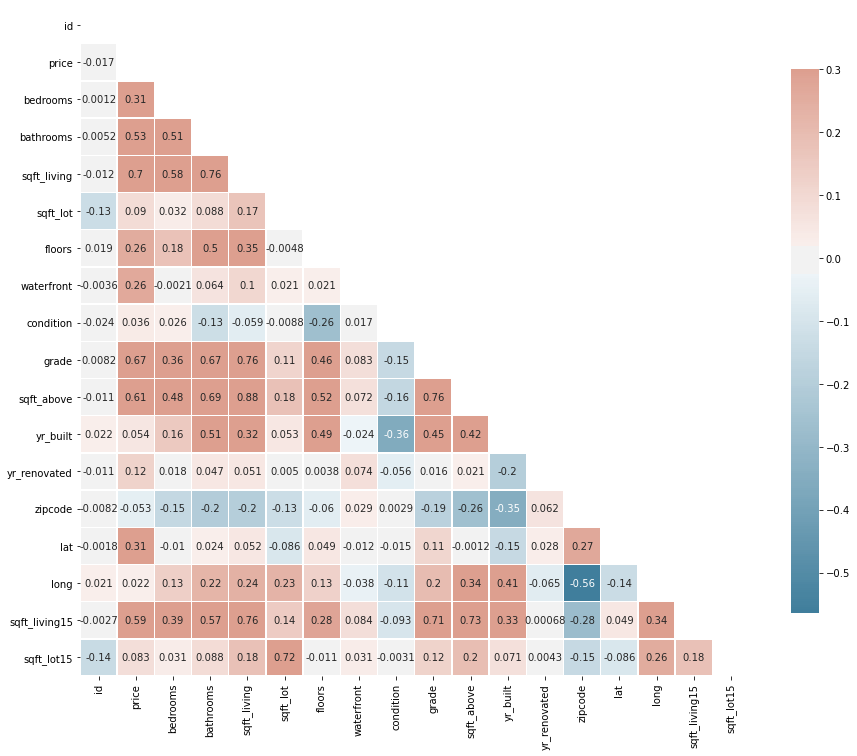

In [959]:
# Initial correlations in main dataset after cleansing
correlation_view(data, annot=True)

In [960]:
# Obtain ordered list of variables with high correlation with target variable, price
data.corr().price.sort_values(ascending=False)
# Grade, sqft_living, sqft_above, sqft_living15, bathrooms are most correlated with price

price            1.000000
sqft_living      0.701917
grade            0.667951
sqft_above       0.605368
sqft_living15    0.585241
bathrooms        0.525906
bedrooms         0.308787
lat              0.306692
waterfront       0.264306
floors           0.256804
yr_renovated     0.117855
sqft_lot         0.089876
sqft_lot15       0.082845
yr_built         0.053953
condition        0.036056
long             0.022036
id              -0.016772
zipcode         -0.053402
Name: price, dtype: float64

# Phase 1: First Models and Editing Data for Business Case

## Model 1: Nothing But Data Cleanse <a id="Model_1"></a>

In [961]:
model_scores(data, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# Training > Testing so slightly overfit

Training Scores:
R2: 0.696
Mean Absolute Error: 129057.129
Root Mean Squared Error: 204151.006
---
Testing Scores:
R2: 0.68
Mean Absolute Error: 128165.89
Root Mean Squared Error: 204432.439


In [962]:
# plot_map(data)

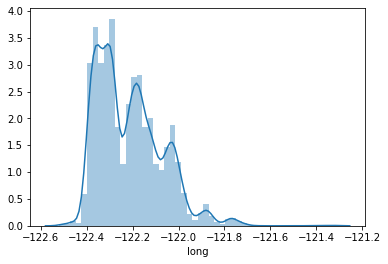

In [963]:
# Map showing outliers mostly in the east, look at distribution of longitude (east/west)
sns.distplot(data['long'])

In [964]:
# Different look at distribuion numbers. Can see max outlier
data['long'].describe()

count    21597.000000
mean      -122.213982
std          0.140724
min       -122.519000
25%       -122.328000
50%       -122.231000
75%       -122.125000
max       -121.315000
Name: long, dtype: float64

In [965]:
# Filter down data to 75% and remap
data_longzoom = data[data['long'] <= -122.125]

In [966]:
# Cut out 25% of records, but should be better for model to have a more condensed space
data_longzoom.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16214 entries, 0 to 21596
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             16214 non-null  int64         
 1   date           16214 non-null  datetime64[ns]
 2   price          16214 non-null  float64       
 3   bedrooms       16214 non-null  int64         
 4   bathrooms      16214 non-null  float64       
 5   sqft_living    16214 non-null  int64         
 6   sqft_lot       16214 non-null  int64         
 7   floors         16214 non-null  float64       
 8   waterfront     16214 non-null  float64       
 9   condition      16214 non-null  int64         
 10  grade          16214 non-null  int64         
 11  sqft_above     16214 non-null  int64         
 12  sqft_basement  16214 non-null  object        
 13  yr_built       16214 non-null  int64         
 14  yr_renovated   16214 non-null  int64         
 15  zipcode        1621

In [967]:
# Replot map with zoomed in longitudes
plot_map(data_longzoom)

In [968]:
# How many zipcodes accounted for before?
data['zipcode'].nunique()

70

In [969]:
# Zipcodes down from 70 to 57
data_longzoom['zipcode'].nunique()

57

## Model 2: Pared down locations <a id="Model_2"></a>

In [970]:
model_scores(data_longzoom, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# No real change in R-squared, slightly higher test vs full previous dataset
# Training > Testing so slightly overfit

Training Scores:
R2: 0.696
Mean Absolute Error: 135584.93
Root Mean Squared Error: 208699.643
---
Testing Scores:
R2: 0.693
Mean Absolute Error: 138727.36
Root Mean Squared Error: 226383.5


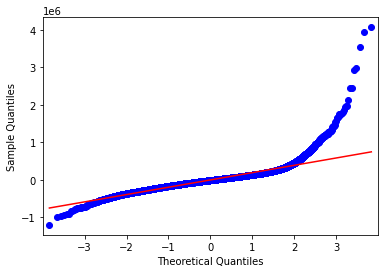

In [971]:
qq_plot(data_longzoom, remove=['price', 'date', 'id'], target='price')

In [972]:
high_corr(data_longzoom, 0.7)
# 0.8 correlation is severe multi-collinearity - http://www.sfu.ca/~dsignori/buec333/lecture%2016.pdf
# Plenty of highly correlated features to address - sqft_living and sqft_above is severe and should be first priority

,level_0,level_1,0
22,price,sqft_living,0.703570
58,bathrooms,sqft_living,0.743494
73,sqft_living,price,0.703570
75,sqft_living,bathrooms,0.743494
81,sqft_living,grade,0.740156
82,sqft_living,sqft_above,0.858212
88,sqft_living,sqft_living15,0.717626
166,grade,sqft_living,0.740156
172,grade,sqft_above,0.730115
184,sqft_above,sqft_living,0.858212


# Phase 2: Addressing Highly Correlated Xs and Feature Engineering

## Investigating and Addressing Outliers

In [973]:
# Descibe full data set to see any glaring outliers
data_longzoom.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,1.621400e+04,1.621400e+04,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000,16214.000000
mean,4.545986e+09,5.335436e+05,3.333169,2.029049,1971.582953,9514.380165,1.446620,0.007278,3.452695,7.523066,1646.579623,1965.249661,78.429074,98088.893672,47.567007,-122.278792,1875.384791,8541.404404
std,2.830427e+09,3.889760e+05,0.962320,0.773342,870.450928,17842.969808,0.547647,0.085001,0.675099,1.108744,746.344090,29.921309,387.861676,56.322623,0.136745,0.081437,618.795222,11885.730426
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,520.000000,1.000000,0.000000,1.000000,4.000000,370.000000,1900.000000,0.000000,98001.000000,47.257400,-122.519000,399.000000,651.000000
25%,2.172000e+09,3.100000e+05,3.000000,1.500000,1360.000000,4929.250000,1.000000,0.000000,3.000000,7.000000,1130.000000,1946.000000,0.000000,98034.000000,47.480425,-122.349000,1440.000000,5000.000000
50%,3.885802e+09,4.350000e+05,3.000000,2.000000,1810.000000,7265.500000,1.000000,0.000000,3.000000,7.000000,1440.000000,1965.000000,0.000000,98105.000000,47.577200,-122.292000,1750.000000,7350.000000
75%,7.212651e+09,6.230000e+05,4.000000,2.500000,2400.000000,9647.000000,2.000000,0.000000,4.000000,8.000000,1970.000000,1990.000000,0.000000,98125.000000,47.682875,-122.202000,2190.000000,9350.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,12050.000000,843309.000000,3.500000,1.000000,5.000000,13.000000,8860.000000,2015.000000,2015.000000,98199.000000,47.777600,-122.125000,5790.000000,380279.000000


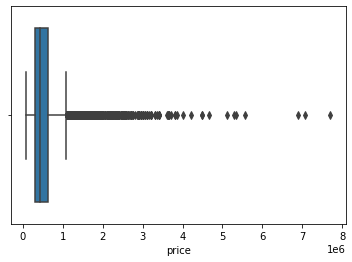

In [974]:
# Clear outlier in max price
sns.boxplot(data_longzoom['price'])
# 1.25 mil accounts for most

In [975]:
# Current shape
data_longzoom.shape

(16214, 20)

In [976]:
# How many records left when taking out outliers
data_longzoom[data_longzoom['price'] <= 1250000]['id'].count()

15474

In [977]:
(16214-15474)/16214
# 4% of data, but outliers will impact model success

0.04563957074133465

In [978]:
# Create "master variable" data_focused and filter out price outliers
data_focused = data_longzoom[data_longzoom['price'] <= 1250000]

In [979]:
# Bedrooms also had outliers
data_focused['bedrooms'].describe()

count    15474.000000
mean         3.294494
std          0.946613
min          1.000000
25%          3.000000
50%          3.000000
75%          4.000000
max         33.000000
Name: bedrooms, dtype: float64

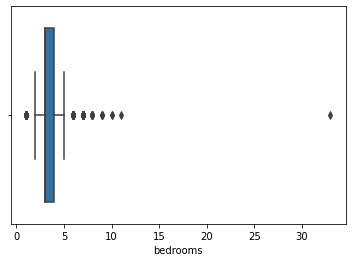

In [980]:
sns.boxplot(data_focused['bedrooms'])
# 1-5 bedrooms looks like where data is concentrated

In [981]:
# How many records in 1-5 bedroom range?
data_focused[(data_focused['bedrooms'] >=1) & (data_focused['bedrooms'] <=5)]['id'].count()

15231

In [982]:
(15474-15231)/15474
# Another 1% of data loss, but for betterment of model and concentration

0.015703761147731678

In [983]:
# Update master variable and dataframe
data_focused = data_focused[(data_focused['bedrooms'] >=1) & (data_focused['bedrooms'] <=5)]

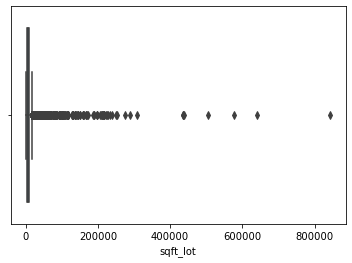

In [984]:
#Sqft_lot also had outliers
sns.boxplot(data_focused['sqft_lot'])

In [985]:
data_focused['sqft_lot'].describe()

count     15231.000000
mean       9236.394196
std       17938.694219
min         520.000000
25%        4800.000000
50%        7203.000000
75%        9506.500000
max      843309.000000
Name: sqft_lot, dtype: float64

In [986]:
# Many over the 75% mark, but few above 30000. Remove these
(data_focused['sqft_lot']>=30000).sum()

390

In [987]:
# Update master variable and dataframe
data_focused = data_focused[data_focused['sqft_lot']<30000]

In [988]:
# Check bathrooms since they have more detailed measurement and large range (in context of 5 bedroom houses)
data_focused.groupby(by='bathrooms')['id'].count()

bathrooms
0.50       4
0.75      47
1.00    3389
1.25       7
1.50    1230
1.75    2371
2.00    1465
2.25    1386
2.50    3056
2.75     721
3.00     470
3.25     257
3.50     327
3.75      48
4.00      33
4.25      15
4.50      13
4.75       1
5.00       1
Name: id, dtype: int64

In [989]:
# Create new column for full baths to consolidate data values
data_focused['full_bath'] = 0

# For each value in data['bathrooms']
for row in data_focused['bathrooms'].index:
    if (data_focused['bathrooms'][row] <1):
        data_focused['full_bath'][row] = 0
    if (data_focused['bathrooms'][row] >=1) and (data_focused['bathrooms'][row] <2):
        data_focused['full_bath'][row] = 1
    if (data_focused['bathrooms'][row] >=2) and (data_focused['bathrooms'][row] <3):
        data_focused['full_bath'][row] = 2
    if (data_focused['bathrooms'][row] >=3) and (data_focused['bathrooms'][row] <4):
        data_focused['full_bath'][row] = 3
    if (data_focused['bathrooms'][row] >=4) and (data_focused['bathrooms'][row] <5):
        data_focused['full_bath'][row] = 4
    if (data_focused['bathrooms'][row] >=5) and (data_focused['bathrooms'][row] <6):
        data_focused['full_bath'][row] = 5

<ipython-input-989-8bc225fe4a62>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['full_bath'][row] = 1
<ipython-input-989-8bc225fe4a62>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['full_bath'][row] = 2
<ipython-input-989-8bc225fe4a62>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['full_bath'][row] = 3
<ipython-input-989-8bc225fe4a62>:7: SettingWithCopyWarning: 
A value is trying to be s

In [990]:
# Overview into new distribution of bathroom counts
data_focused.groupby(by='full_bath')['id'].count()

full_bath
0      51
1    6997
2    6628
3    1102
4      62
5       1
Name: id, dtype: int64

In [991]:
# Majority of data is between 1 and 3 baths
data_focused[(data_focused['full_bath']>0) & (data_focused['full_bath']<4)]['id'].count()

14727

In [992]:
(15223-15096)/15223
# Less than 1% loss in removing outliers

0.008342639427182552

In [993]:
# Update master variable
data_focused = data_focused[(data_focused['full_bath']>0) & (data_focused['full_bath']<4)]

In [994]:
# Update master variable and drop bathroom since it was source of full_bath and only need one in model
data_focused = data_focused.drop(labels='bathrooms', axis=1)

In [995]:
data_focused.info()
# Homes with price <= $1.25 million, 1-5 bedrooms, 1-3 bathrooms (full_bath), smaller geographical area

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14727 entries, 0 to 21593
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             14727 non-null  int64         
 1   date           14727 non-null  datetime64[ns]
 2   price          14727 non-null  float64       
 3   bedrooms       14727 non-null  int64         
 4   sqft_living    14727 non-null  int64         
 5   sqft_lot       14727 non-null  int64         
 6   floors         14727 non-null  float64       
 7   waterfront     14727 non-null  float64       
 8   condition      14727 non-null  int64         
 9   grade          14727 non-null  int64         
 10  sqft_above     14727 non-null  int64         
 11  sqft_basement  14727 non-null  object        
 12  yr_built       14727 non-null  int64         
 13  yr_renovated   14727 non-null  int64         
 14  zipcode        14727 non-null  int64         
 15  lat            1472

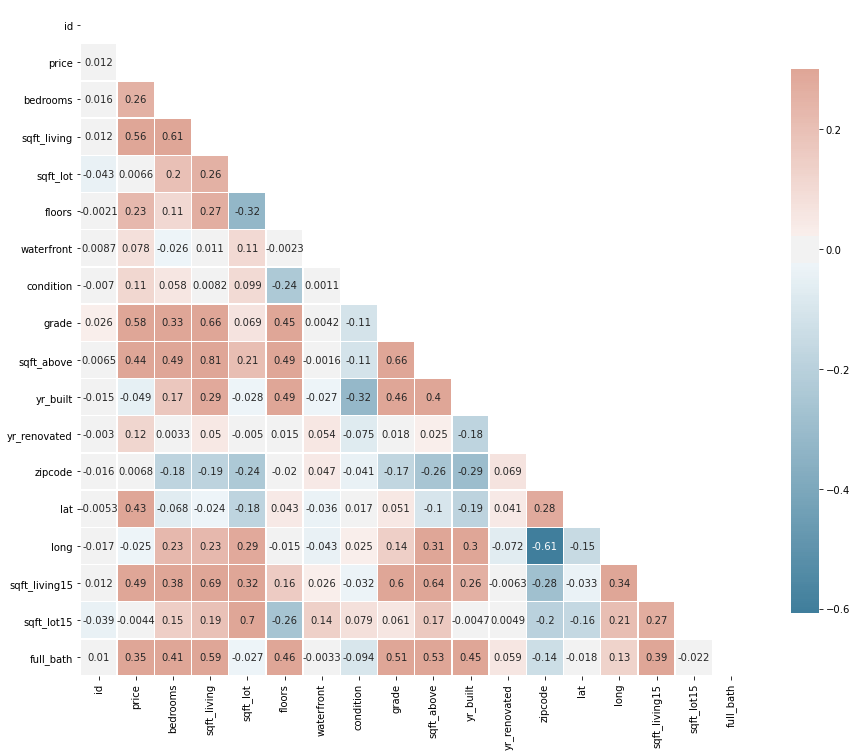

In [996]:
# Review correlations with edited dataset
correlation_view(data_focused, annot=True)

In [997]:
high_corr(data_focused,0.7)
# Removing outliers addressed many of previously high correlation features
# sqft_above and sqft_living is still high at .8.
# Test without sqft_above as sqft_living has higher correlation with price

,level_0,level_1,0
63,sqft_living,sqft_above,0.80977
165,sqft_above,sqft_living,0.80977


## Model 3: Model without sqft_above <a id="Model_3"></a>

In [998]:
# Create new variable for test table without sqft_above
data_focused_nosfa = data_focused.drop(labels='sqft_above', axis=1)

In [999]:
model_scores(data_focused_nosfa, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# R-squared down, but expected because of high correlation between the two
# Testing > Training so slightly underfit

Training Scores:
R2: 0.67
Mean Absolute Error: 93379.26
Root Mean Squared Error: 125055.975
---
Testing Scores:
R2: 0.681
Mean Absolute Error: 93135.831
Root Mean Squared Error: 124364.04


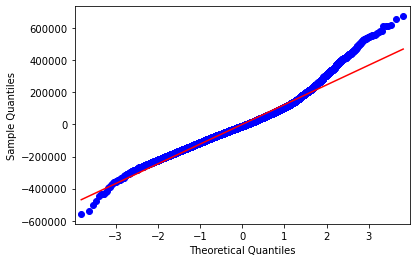

In [1000]:
qq_plot(data_focused_nosfa, remove=['price', 'date', 'id'], target='price')

In [1001]:
high_corr(data_focused_nosfa, 0.7)
# Check back on correlations. None over 0.7 now.

,level_0,level_1,0


In [1002]:
# Reassign master variable
data_focused = data_focused_nosfa

## Additional Feature Engineering and Replacement

In [1003]:
data_focused[data_focused['sqft_basement']==0]['id'].count()
# Nearly half of dataset doesn't have basement

8331

In [1004]:
# Create column for has_basement, input Boolean values (1 if has a basement) and replace sqft_basement
data_focused['has_basement'] = 0

for row in data_focused['sqft_basement'].index:
    if (data_focused['sqft_basement'][row] > 0.0):
        data_focused['has_basement'][row] = 1
    else:
        data_focused['has_basement'][row] = 0

<ipython-input-1004-08e2cdac7c5a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['has_basement'][row] = 0
<ipython-input-1004-08e2cdac7c5a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['has_basement'][row] = 1


In [1005]:
data_focused[data_focused['yr_renovated']==0]['id'].count()
# Most homes haven't been renovated

14231

In [1006]:
# Create new column for Boolean has_been_renovated
data_focused['has_been_renovated'] = 0

# For each value in data['yr_renovated'], if 0 put 0 in has_been_renovated; 1 if it has other values
for row in data_focused['yr_renovated'].index:
    if data_focused['yr_renovated'][row] == 0:
        data_focused['has_been_renovated'][row] = 0
    elif data_focused['yr_renovated'][row] > 0:
        data_focused['has_been_renovated'][row] = 1

<ipython-input-1006-e1927eecb0d8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['has_been_renovated'][row] = 0
<ipython-input-1006-e1927eecb0d8>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['has_been_renovated'][row] = 1


In [1007]:
# Update master variable and drop replaced columns ()
data_focused = data_focused.drop(labels=['sqft_basement', 'yr_renovated'], axis=1)

In [1008]:
data_focused.columns

Index(['id', 'date', 'price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'yr_built', 'zipcode', 'lat',
       'long', 'sqft_living15', 'sqft_lot15', 'full_bath', 'has_basement',
       'has_been_renovated'],
      dtype='object')

In [1009]:
# Create age from yr_built
data_focused['age'] = 0

In [1010]:
# Also need year of sale for age
data_focused['yr_of_sale'] = pd.DatetimeIndex(data_focused['date']).year

In [1011]:
# Check work
data_focused['yr_of_sale'].head()

0    2014
1    2014
2    2015
3    2014
6    2014
Name: yr_of_sale, dtype: int64

In [1012]:
for row in data_focused['age'].index:
    data_focused['age'][row] = data_focused['yr_of_sale'][row] - data_focused['yr_built'][row]

<ipython-input-1012-59e13b09e762>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_focused['age'][row] = data_focused['yr_of_sale'][row] - data_focused['yr_built'][row]


In [1013]:
data_focused['age'].describe()
# min is -1 need to take out negatives, data errors means sold before built

count    14727.000000
mean        49.278740
std         29.820287
min         -1.000000
25%         25.000000
50%         50.000000
75%         68.000000
max        115.000000
Name: age, dtype: float64

In [1014]:
# How many records have negative age value
data_focused[data_focused['age'] <0]['id'].count()

11

In [1015]:
# Update master variable to filter out negative age values
data_focused = data_focused[data_focused['age'] >=0]

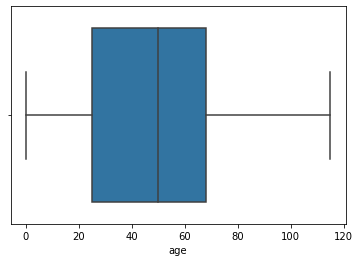

In [1016]:
# Boxplot of age to see general distribution and extremes
sns.boxplot(data_focused['age'])

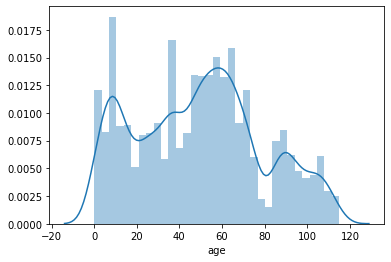

In [1017]:
# Different view of distribution to explore age > 70 occurance
sns.distplot(data_focused['age'])

In [1018]:
# Take out columns used to assist in building this feature - would contribute to multicollinearity
data_focused = data_focused.drop(labels=['yr_of_sale', 'yr_built'], axis=1)

In [1019]:
data_focused = data_focused[data_focused['age'] >=0]

In [1020]:
# Check work
data_focused.columns

Index(['id', 'date', 'price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'full_bath', 'has_basement',
       'has_been_renovated', 'age'],
      dtype='object')

## Model 4: New Features and Booleans <a id="Model_4"></a>

In [1021]:
model_scores(data_focused, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# R-squared slightly up and data simplified
# Testing > Training so slightly underfit

Training Scores:
R2: 0.672
Mean Absolute Error: 92948.693
Root Mean Squared Error: 124292.556
---
Testing Scores:
R2: 0.681
Mean Absolute Error: 93117.546
Root Mean Squared Error: 125178.436


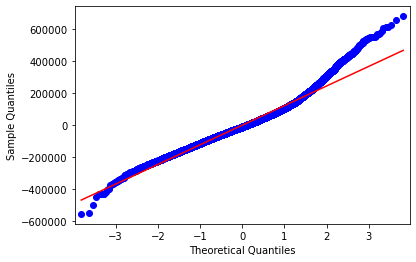

In [1022]:
qq_plot(data_focused, remove=['price', 'date', 'id'], target='price')
# similar qq plot, straying at 2 deviations from mean

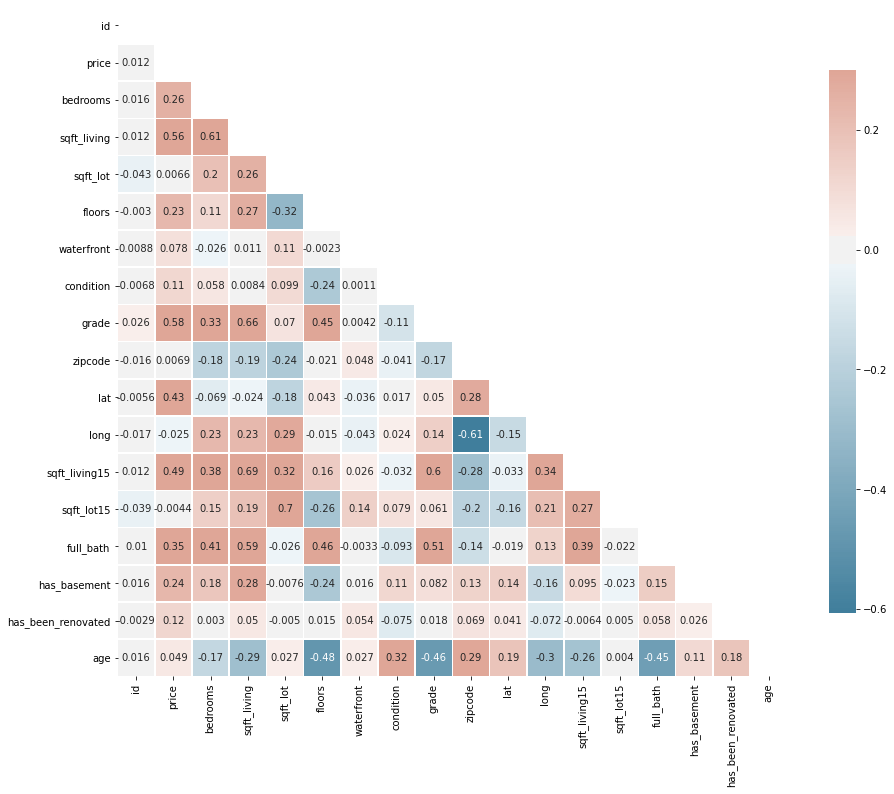

In [1023]:
correlation_view(data_focused, annot=True)

In [1024]:
# Nothing over 0.7, checking 0.6 as thresh
high_corr(data_focused, 0.6)
# Sqft_lot15 has high correlation with sqft_lot. Sqft_lot has slightly higher correlation with price and
# is related to the specific property versus the area. Test without sqft_lot15

,level_0,level_1,0
39,bedrooms,sqft_living,0.612915
56,sqft_living,bedrooms,0.612915
62,sqft_living,grade,0.660963
66,sqft_living,sqft_living15,0.685718
85,sqft_lot,sqft_lot15,0.699094
147,grade,sqft_living,0.660963
156,grade,sqft_living15,0.603016
219,sqft_living15,sqft_living,0.685718
224,sqft_living15,grade,0.603016
238,sqft_lot15,sqft_lot,0.699094


## Model 5: Testing without sqft_lot15 <a id="Model_5"></a>

In [1025]:
# Create new variable for test table without sqft_lot15
data_focused_nolot15_test = data_focused.drop(labels='sqft_lot15', axis=1)

In [1026]:
model_scores(data_focused_nolot15_test, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# R-squared same - Keep sqft_lot15 off
# Testing > Training so slightly underfit

Training Scores:
R2: 0.672
Mean Absolute Error: 92979.976
Root Mean Squared Error: 124340.25
---
Testing Scores:
R2: 0.681
Mean Absolute Error: 93162.869
Root Mean Squared Error: 125270.939


In [1027]:
# Reassign master variable
data_focused = data_focused_nolot15_test

In [1028]:
# Review columns, check work
data_focused.columns

Index(['id', 'date', 'price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'zipcode', 'lat', 'long',
       'sqft_living15', 'full_bath', 'has_basement', 'has_been_renovated',
       'age'],
      dtype='object')

In [1029]:
# Nothing over 0.7, checking 0.6 as thresh
high_corr(data_focused, 0.6)
# Sqft_living15 has high correlation with sqft_living. Sqft_living has slightly higher correlation with price and
# is related to the specific property versus the area. Test without sqft_living15

,level_0,level_1,0
37,bedrooms,sqft_living,0.612915
53,sqft_living,bedrooms,0.612915
59,sqft_living,grade,0.660963
63,sqft_living,sqft_living15,0.685718
139,grade,sqft_living,0.660963
148,grade,sqft_living15,0.603016
207,sqft_living15,sqft_living,0.685718
212,sqft_living15,grade,0.603016


## Model 6: Testing without sqft_living15 <a id="Model_6"></a>

In [1030]:
# Sqft_living15 also had high correlaton with sqft_living. Create new variable to test without
data_focused_noliv15_test = data_focused.drop(labels='sqft_living15', axis=1)

In [1031]:
model_scores(data_focused_noliv15_test, remove=['price', 'date', 'id'], target =['price'], testsize=0.33, rs=42)
# R-squared down, but expected - need to rid of highly correlated variables that measure similar things
# Testing > Training so slightly underfit

Training Scores:
R2: 0.658
Mean Absolute Error: 94555.599
Root Mean Squared Error: 126852.587
---
Testing Scores:
R2: 0.669
Mean Absolute Error: 94771.598
Root Mean Squared Error: 127640.594


In [1032]:
# Reassign master variable
data_focused = data_focused_noliv15_test

In [1033]:
# Check work, view columns
data_focused.columns

Index(['id', 'date', 'price', 'bedrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'zipcode', 'lat', 'long',
       'full_bath', 'has_basement', 'has_been_renovated', 'age'],
      dtype='object')

In [1034]:
# Nothing over 0.7, checking 0.6 as thresh
high_corr(data_focused,0.6)
# Down to only 2 correlations - bedrooms and sqft_living / sqft_living and grade
# Will move on to additional levers and come back if needed.

,level_0,level_1,0
35,bedrooms,sqft_living,0.612915
50,sqft_living,bedrooms,0.612915
56,sqft_living,grade,0.660963
131,grade,sqft_living,0.660963


# Phase 3: Log Transforms and OHE

## Log transform continuous variables

In [1035]:
continuous = ['price', 'sqft_living', 'sqft_lot']

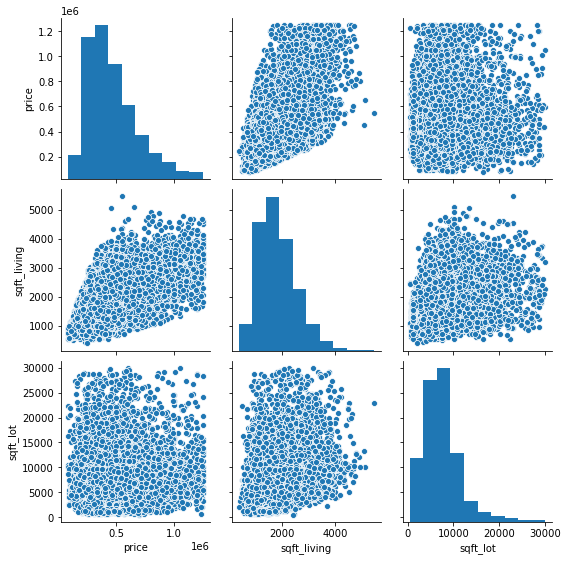

In [1036]:
# View distributions
sns.pairplot(data_focused[continuous])
# continuous are skewed left

In [1037]:
# continuous are skewed left, log transform
data_focused_cont = data_focused[continuous]

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f93f2ca2f10>,
      dtype=object)

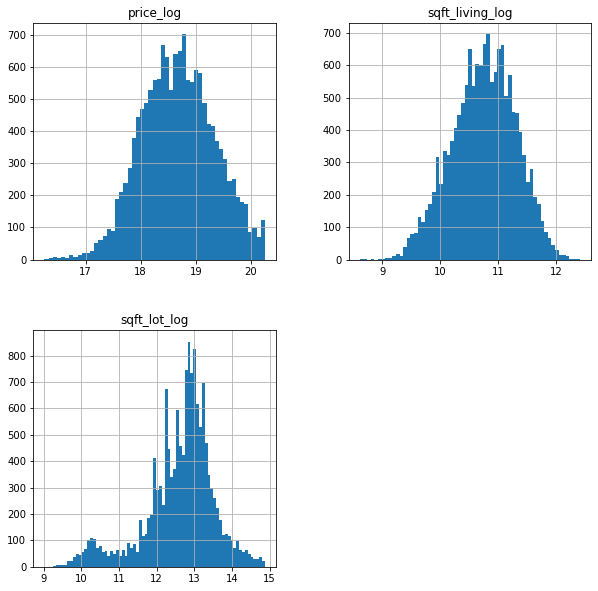

In [1038]:
#  Create new columns with "_log" for log transformed values
log_names = [f'{column}_log' for column in data_focused_cont.columns] 

# Log transform, create a new table with log_names as column names, plot new values
data_focused_log = np.log2(data_focused_cont) #Changed to log 1p insttead of log2
data_focused_log.columns = log_names
data_focused_log.hist(figsize=(10, 10), bins='auto')

In [1039]:
# Preview table
data_focused_log

,price_log,sqft_living_log,sqft_lot_log
0,17.759550,10.204571,12.464035
1,19.037247,11.327553,12.822172
2,17.457637,9.588715,13.287712
3,19.204189,10.936638,12.287712
6,17.974213,10.743993,12.735344
...,...,...,...
21589,19.220069,11.299208,12.556267
21590,19.945924,11.777255,12.813781
21591,18.857568,10.355351,10.337622
21592,18.457637,10.579316,10.143383


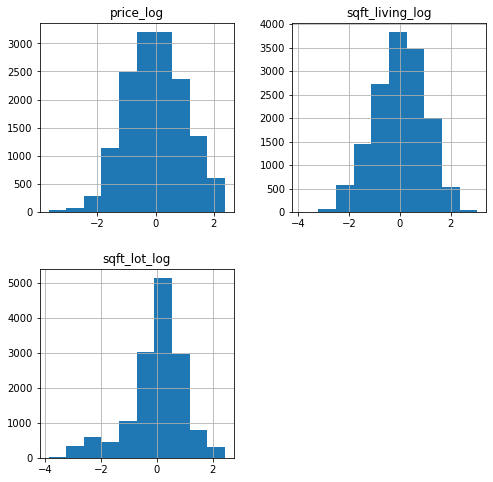

In [1040]:
# Standardize the continuous variables
def normalize(feature):
    return (feature - feature.mean()) / feature.std()

features_final = data_focused_log.apply(normalize)

features_final.hist(figsize  = [8, 8]);

In [1041]:
# Create new table with logs replacing original columns and values
data_focused_with_logs = pd.concat([data_focused, features_final],axis=1)
data_focused_with_logs = data_focused_with_logs.drop(labels=['sqft_lot'], axis=1) 
#removed dropping 'price' 

In [1042]:
data_focused_with_logs.columns

Index(['id', 'date', 'price', 'bedrooms', 'sqft_living', 'floors',
       'waterfront', 'condition', 'grade', 'zipcode', 'lat', 'long',
       'full_bath', 'has_basement', 'has_been_renovated', 'age', 'price_log',
       'sqft_living_log', 'sqft_lot_log'],
      dtype='object')

## Model 7: Post Log-Transform <a id="Model_7"></a>

In [1043]:
model_scores(data_focused_with_logs, remove=['price_log', 'price', 'sqft_living', 'date', 'id'], target='price_log', testsize=0.33, 
             rs=42)
# R2 +0.04. Testing > Training, so slightly underfit
# RMSEs Logged. More manual code below to unlog these values to $ amount

Training Scores:
R2: 0.7
Mean Absolute Error: 0.425
Root Mean Squared Error: 0.546
---
Testing Scores:
R2: 0.705
Mean Absolute Error: 0.426
Root Mean Squared Error: 0.548


#### Manual code to unlog and get RMSE in dollars

In [1044]:
def evaluate_model(y_train, y_test, y_pred_train, y_pred_test):
    """Evaluates model on y_train, y_test, y_pred_train, y_pred_test and calculates R2, Mean Absolute Error, and
    Root Mean Absolute Error. This is separated out in order to give access to these datasets for unlogging.
    --
    Inputs:
    - y_train - true target for training set (derived from train_test_split)
    - y_test - true target for test set (derived from train_test_split)
    - y_pred_train - predicted target for training set
    - y_pred_test - predicted target for test set
    --
    No Outputs
    """
    print("Training Scores:")
    print(f"R2: {round(r2_score(y_train, y_pred_train),3)}") #can account for X amount of variance
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_train, y_pred_train),3)}") #about X amount off in predicting price
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_train, y_pred_train, squared=False),3)}")
    print("---")
    print("Testing Scores:")
    print(f"R2: {round(r2_score(y_test, y_pred_test),3)}")
    print(f"Mean Absolute Error: {round(mean_absolute_error(y_test, y_pred_test),3)}")
    print(f"Root Mean Squared Error: {round(mean_squared_error(y_test, y_pred_test, squared=False),3)}")

In [1045]:
# Define X and y
X_cols = [c for c in data_focused_with_logs.columns.to_list() if c not in ['price_log', 'price', 'sqft_living', 'date', 'id']] 
X = data_focused_with_logs[X_cols]
y = data_focused_with_logs['price']
# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [1046]:
# Log y
y_train_log = np.log1p(y_train)
y_test_log = np.log1p(y_test)

In [1047]:
# Instantiate
lr = LinearRegression()
# Fit training data
lr.fit(X_train, y_train_log)
# Grab predictions for train and test set, these will now be in log terms
y_pred_train_log = lr.predict(X_train)
y_pred_test_log = lr.predict(X_test)

In [1048]:
evaluate_model(y_train_log, y_test_log, y_pred_train_log, y_pred_test_log)

Training Scores:
R2: 0.7
Mean Absolute Error: 0.195
Root Mean Squared Error: 0.25
---
Testing Scores:
R2: 0.705
Mean Absolute Error: 0.195
Root Mean Squared Error: 0.251


In [1049]:
# Unlog y_pred_test
y_pred_train = np.exp(y_pred_train_log)
y_pred_test = np.exp(y_pred_test_log)

In [1050]:
# Recalculate Train and Test RMSE
print(f"Train RMSE: {mean_squared_error(y_train, y_pred_train, squared=False):.3f}")
print(f"Test RMSE: {mean_squared_error(y_test, y_pred_test, squared=False):.3f}")
# Model about $129k amount off in predicting price

Train RMSE: 127936.893
Test RMSE: 128559.926


In [1051]:
#Sanity check, matches logged RMSE from evaluate_model
print(f"Train RMSE Logged: {round(mean_squared_error(y_train_log, y_pred_train_log, squared=False),3)}")
print(f"Test RMSE Logged: {round(mean_squared_error(y_test_log, y_pred_test_log, squared=False),3)}")

Train RMSE Logged: 0.25
Test RMSE Logged: 0.251


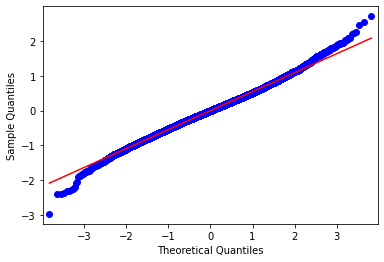

In [1052]:
qq_plot(data_focused_with_logs, remove=['price_log', 'price', 'sqft_living', 'date', 'id'], target='price_log')
# qqplot line MASSIVELY improved, outliers ~3 deviations from mean impacted

In [1053]:
# Update master variable
data_focused = data_focused_with_logs

## Model 8: OHE zipcode <a id="Model_8"></a>

In [1054]:
# Look into zipcodes
set(data_focused['zipcode'])

{98001,
 98002,
 98003,
 98004,
 98005,
 98006,
 98007,
 98008,
 98011,
 98023,
 98027,
 98028,
 98030,
 98031,
 98032,
 98033,
 98034,
 98039,
 98040,
 98042,
 98052,
 98055,
 98056,
 98058,
 98059,
 98070,
 98072,
 98092,
 98102,
 98103,
 98105,
 98106,
 98107,
 98108,
 98109,
 98112,
 98115,
 98116,
 98117,
 98118,
 98119,
 98122,
 98125,
 98126,
 98133,
 98136,
 98144,
 98146,
 98148,
 98155,
 98166,
 98168,
 98177,
 98178,
 98188,
 98198,
 98199}

In [1055]:
cat_cols = ['zipcode']

In [1056]:
data_focused_zipohe = pd.get_dummies(data_focused, columns=cat_cols)

In [1057]:
data_focused_zipohe.head()

,id,date,price,bedrooms,sqft_living,floors,waterfront,condition,grade,lat,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,7129300520,2014-10-13,221900.0,3,1180,1.0,0.0,3,7,47.5112,...,0,0,0,0,0,0,1,0,0,0
1,6414100192,2014-12-09,538000.0,3,2570,2.0,0.0,3,7,47.7210,...,0,0,0,0,0,0,0,0,0,0
2,5631500400,2015-02-25,180000.0,2,770,1.0,0.0,3,6,47.7379,...,0,0,0,0,0,0,0,0,0,0
3,2487200875,2014-12-09,604000.0,4,1960,1.0,0.0,5,7,47.5208,...,0,0,0,0,0,0,0,0,0,0
6,1321400060,2014-06-27,257500.0,3,1715,2.0,0.0,3,7,47.3097,...,0,0,0,0,0,0,0,0,0,0


In [1058]:
len(list(data_focused_zipohe.columns))

75

In [1059]:
model_scores(data_focused_zipohe, remove=['price_log', 'price', 'sqft_living', 'date', 'id'], target =['price_log'], testsize=0.33, rs=42)
# R-squared from 0.70 to .83
# Training and Test score are extremely close - if anything very slightly overfit with Training .002 > Testing
# MSE and RMSE trending down from .425 and .652

Training Scores:
R2: 0.836
Mean Absolute Error: 0.3
Root Mean Squared Error: 0.403
---
Testing Scores:
R2: 0.838
Mean Absolute Error: 0.301
Root Mean Squared Error: 0.406


In [1060]:
high_corr(data_focused_zipohe, 0.6)
# No additional high correlation variables of those not removed from Dataframe

,level_0,level_1,0
88,price,price_log,0.960251
151,bedrooms,sqft_living,0.612915
163,bedrooms,sqft_living_log,0.645531
224,sqft_living,bedrooms,0.612915
229,sqft_living,grade,0.660963
237,sqft_living,sqft_living_log,0.971761
521,grade,sqft_living,0.660963
533,grade,sqft_living_log,0.650787
1037,price_log,price,0.960251
1112,sqft_living_log,bedrooms,0.645531


#### Manual code to unlog and get RMSE in dollars

In [1061]:
# Define X and y
X_cols = [c for c in data_focused_zipohe.columns.to_list() if c not in ['price_log', 'price',  'sqft_living', 'date', 'id']] 
X = data_focused_zipohe[X_cols]
y = data_focused_zipohe['price']
# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [1062]:
# Log y
y_train_log = np.log1p(y_train)
y_test_log = np.log1p(y_test)

In [1063]:
# Instantiate
lr = LinearRegression()
# Fit training data
lr.fit(X_train, y_train_log)
# Grab predictions for train and test set, these will now be in log terms
y_pred_train_log = lr.predict(X_train)
y_pred_test_log = lr.predict(X_test)

In [1064]:
evaluate_model(y_train_log, y_test_log, y_pred_train_log, y_pred_test_log)

Training Scores:
R2: 0.836
Mean Absolute Error: 0.137
Root Mean Squared Error: 0.185
---
Testing Scores:
R2: 0.838
Mean Absolute Error: 0.138
Root Mean Squared Error: 0.186


In [1065]:
# Unlog y_pred_test
y_pred_train = np.exp(y_pred_train_log)
y_pred_test = np.exp(y_pred_test_log)

In [1066]:
# Recalculate Train and Test RMSE
print(f"Train RMSE: {mean_squared_error(y_train, y_pred_train, squared=False):.3f}")
print(f"Test RMSE: {mean_squared_error(y_test, y_pred_test, squared=False):.3f}")
# Model about $129k amount off in predicting price

Train RMSE: 90505.332
Test RMSE: 90878.305


In [1067]:
#Sanity check, matches logged RMSE from evaluate_model
print(f"Train RMSE Logged: {round(mean_squared_error(y_train_log, y_pred_train_log, squared=False),3)}")
print(f"Test RMSE Logged: {round(mean_squared_error(y_test_log, y_pred_test_log, squared=False),3)}")

Train RMSE Logged: 0.185
Test RMSE Logged: 0.186


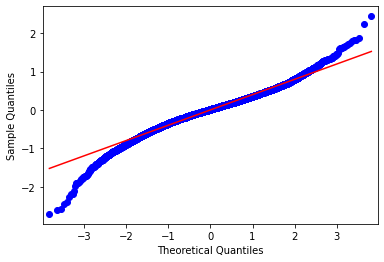

In [1068]:
qq_plot(data_focused_zipohe, remove=['price_log', 'price', 'sqft_living', 'date', 'id'], target='price_log')
# qqplot line drops off at extremes

In [1069]:
# Update master variable
data_focused = data_focused_zipohe

### Increased R-squared Test Score from 0.680 to 0.838 (23%), and Decreased RMSE from 204432 to 90878 (55%)

## Model 9: Apply Standard Scaler to data <a id="Model_9"></a>

In [1070]:
model_scores_stanscale(data_focused, remove=['price_log', 'price', 'sqft_living', 'date', 'id'], target =['price_log'], testsize=0.33, 
                       rs=42)
# Same R2 scores (as expected)

Training Scores:
R2: 0.836
Mean Absolute Error: 0.3
Root Mean Squared Error: 0.403
---
Testing Scores:
R2: 0.838
Mean Absolute Error: 0.301
Root Mean Squared Error: 0.406


#### Manual code to unlog and get RMSE in dollars

In [1071]:
# Define X and y
X_cols = [c for c in data_focused.columns.to_list() if c not in ['price_log', 'price', 'sqft_living', 'date', 'id']] 
X = data_focused[X_cols]
y = data_focused['price']
# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [1072]:
# Log y
y_train_log = np.log1p(y_train)
y_test_log = np.log1p(y_test)

In [1073]:
# Instantiate a new scaler to scale our data with Standard Scaler
scaler = StandardScaler()
# Train scaler on training data, then fit to testing
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [1074]:
# Instantiate
lr = LinearRegression()
# Fit training data
lr.fit(X_train, y_train_log)
# Grab predictions for train and test set, these will now be in log terms
y_pred_train_log = lr.predict(X_train)
y_pred_test_log = lr.predict(X_test)

In [1075]:
evaluate_model(y_train_log, y_test_log, y_pred_train_log, y_pred_test_log)

Training Scores:
R2: 0.836
Mean Absolute Error: 0.137
Root Mean Squared Error: 0.185
---
Testing Scores:
R2: 0.838
Mean Absolute Error: 0.138
Root Mean Squared Error: 0.186


In [1076]:
# Unlog y_pred_test
y_pred_train = np.exp(y_pred_train_log)
y_pred_test = np.exp(y_pred_test_log)

In [1077]:
# Recalculate Train and Test RMSE
print(f"Train RMSE: {mean_squared_error(y_train, y_pred_train, squared=False):.3f}")
print(f"Test RMSE: {mean_squared_error(y_test, y_pred_test, squared=False):.3f}")
# Model about $129k amount off in predicting price

Train RMSE: 90505.332
Test RMSE: 90878.305


In [1078]:
# Sanity check, matches logged RMSE from evaluate_model
print(f"Train RMSE Logged: {round(mean_squared_error(y_train_log, y_pred_train_log, squared=False),3)}")
print(f"Test RMSE Logged: {round(mean_squared_error(y_test_log, y_pred_test_log, squared=False),3)}")

Train RMSE Logged: 0.185
Test RMSE Logged: 0.186


In [1079]:
# Check X columns
X.columns

Index(['bedrooms', 'floors', 'waterfront', 'condition', 'grade', 'lat', 'long',
       'full_bath', 'has_basement', 'has_been_renovated', 'age',
       'sqft_living_log', 'sqft_lot_log', 'zipcode_98001', 'zipcode_98002',
       'zipcode_98003', 'zipcode_98004', 'zipcode_98005', 'zipcode_98006',
       'zipcode_98007', 'zipcode_98008', 'zipcode_98011', 'zipcode_98023',
       'zipcode_98027', 'zipcode_98028', 'zipcode_98030', 'zipcode_98031',
       'zipcode_98032', 'zipcode_98033', 'zipcode_98034', 'zipcode_98039',
       'zipcode_98040', 'zipcode_98042', 'zipcode_98052', 'zipcode_98055',
       'zipcode_98056', 'zipcode_98058', 'zipcode_98059', 'zipcode_98070',
       'zipcode_98072', 'zipcode_98092', 'zipcode_98102', 'zipcode_98103',
       'zipcode_98105', 'zipcode_98106', 'zipcode_98107', 'zipcode_98108',
       'zipcode_98109', 'zipcode_98112', 'zipcode_98115', 'zipcode_98116',
       'zipcode_98117', 'zipcode_98118', 'zipcode_98119', 'zipcode_98122',
       'zipcode_98125', 'zipc

In [1080]:
# Round coefficients 3 decimals to make more legible
lr.coef_ = np.around(lr.coef_,3)

In [1081]:
# Look at the coefficients with the names of each col
var_coeff_dict = dict(zip(X.columns, lr.coef_))
# Create DataFrame for organization
var_coeff_df = pd.DataFrame.from_dict(dict(zip(X.columns, lr.coef_)), orient='index')
var_coeff_df

,0
bedrooms,-0.014
floors,0.007
waterfront,0.604
condition,0.051
grade,0.121
...,...
zipcode_98177,0.042
zipcode_98178,-0.300
zipcode_98188,-0.394
zipcode_98198,-0.404


In [1082]:
# Look for highest coefficients. What zipcodes drive price up?
# zipcode source: https://www.unitedstateszipcodes.org/98011/
var_coeff_df.sort_values(by=0, ascending=False).head(6)
# 98039: Medina
# 98004: Bellevue
# 98112: (Seattle: Mann|Central Area)
# 98102: (Seattle: Eastlake|Cascade)
# 98109: (Seattle: Westlake|Cascade)
# Medina, Bellevue and parts of Seattle are highest positive influencers of price

,0
zipcode_98039,0.753
waterfront,0.604
zipcode_98004,0.581
zipcode_98112,0.477
zipcode_98102,0.471
zipcode_98109,0.451


In [1083]:
# Look at lowest coefficients. What zipcodes drive price down?
var_coeff_df.sort_values(by=0).head(5)
# 98023/98003/98001/98002: Auburn
# 98032: Kent
# Auburn, Kent are highest negative influencers of price

,0
zipcode_98023,-0.518
zipcode_98032,-0.505
zipcode_98003,-0.470
zipcode_98001,-0.468
zipcode_98002,-0.444


In [1084]:
# What areas are around mean influence?
print(f'Mean Coefficient: {round(var_coeff_df[var_coeff_df.columns[0]].mean(),3)}')
print(f'Median Coefficient: {round(var_coeff_df[var_coeff_df.columns[0]].median(),3)}')
var_coeff_df[(var_coeff_df[0]>=-0.01) & (var_coeff_df[0]<=0.02)].sort_values(by=0).head(60)
# 98072: Woodinville
# 98027: Issaquah (far East, boonies)
# 98118: Seattle (Seward Park|Ranier Valley)

Mean Coefficient: 0.011
Median Coefficient: 0.016


,0
zipcode_98072,-0.006
zipcode_98027,-0.000
zipcode_98118,-0.000
age,0.001
floors,0.007


In [1085]:
lr.intercept_

-45.154014479598125

In [1098]:
var_coeff_df.sort_values(by=0, ascending=False).head(60)
# Beyond zipcode waterfront is highest driver of price, 
# then latitude (makes sense with southern Seattle area being mean)
# grade is next highest, has_been_renovated, and condition

,0
zipcode_98039,0.753
waterfront,0.604
zipcode_98004,0.581
zipcode_98112,0.477
zipcode_98102,0.471
zipcode_98109,0.451
zipcode_98119,0.424
zipcode_98105,0.408
zipcode_98040,0.397
zipcode_98107,0.320


## Data Analysis

Looking at the results from the last model, it was clear that zipcodes were main drivers of price especially with that being a large portion the variables considered. From here, analysis was approached by analyzed the top 5 positive price driving zipcodes (df: positive_zips) and the top 5 negative price driving zipcodes (df: negative_zips). This is where it was found that there were around twice as many home records available in the negative zipcodes than the positive ones.

Top 5 Positive Price Driving Zipcodes:
- 98039: Medina
- 98004: Bellevue
- 98112: (Seattle: Mann|Central Area)
- 98109: (Seattle: Westlake|Cascade)
- 98102: (Seattle: Eastlake|Cascade)

Top 5 Negative Price Driving Zipcodes:
- 98023/98001/98003/98002: Auburn
- 98032: Kent

Top Home Feature Positive Price Drivers:
- waterfront
- grade
- condition

In [1087]:
# Create table for zips that drive price up
# 98039: Medina
# 98004: Bellevue
# 98112: (Seattle: Mann|Central Area)
# 98102: (Seattle: Eastlake|Cascade)
# 98109: (Seattle: Westlake|Cascade)
positive_zips = data_focused[(data_focused['zipcode_98039'] == 1) | (data_focused['zipcode_98004'] == 1) | 
             (data_focused['zipcode_98112'] == 1) | (data_focused['zipcode_98109'] == 1) |
             (data_focused['zipcode_98102'] == 1)]

# Create column label, so when merge data for analysis, will know which rows are Positive zips
positive_zips['label']='Positive'

<ipython-input-1087-d544d941bf81>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positive_zips['label']='Positive'


In [1088]:
len(positive_zips)

539

In [1089]:
# Create table for zips that drive price down
# 98032: Kent
# 98023/98001/98003/98002: Auburn
negative_zips = data_focused[(data_focused['zipcode_98032'] == 1) | (data_focused['zipcode_98023'] == 1) | 
             (data_focused['zipcode_98001'] == 1) | (data_focused['zipcode_98003'] == 1) |
             (data_focused['zipcode_98002'] == 1)]

# Create column label, so when merge data for analysis, will know which rows are Negative zips
negative_zips['label']='Negative'

<ipython-input-1089-8b2beaa77979>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  negative_zips['label']='Negative'


In [1090]:
len(negative_zips)
# Over twice as many negative zip records than positive. Explore balancing this more in future.

1388

In [1091]:
# Merge positive_zips and negative_zips tables
extreme_zips = pd.concat([positive_zips, negative_zips])
extreme_zips = extreme_zips.reset_index(drop=True)
extreme_zips

,id,date,price,bedrooms,sqft_living,floors,waterfront,condition,grade,lat,...,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199,label
0,3303700376,2014-12-01,667000.0,3,1400,1.5,0.0,5,8,47.6221,...,0,0,0,0,0,0,0,0,0,Positive
1,3394100030,2014-09-09,975000.0,4,2720,2.0,0.0,3,10,47.5815,...,0,0,0,0,0,0,0,0,0,Positive
2,1952200240,2014-06-11,850830.0,3,2070,1.5,0.0,5,9,47.6415,...,0,0,0,0,0,0,0,0,0,Positive
3,2450000295,2014-10-07,1090000.0,3,2920,2.0,0.0,3,8,47.5814,...,0,0,0,0,0,0,0,0,0,Positive
4,809001525,2014-06-25,890000.0,4,2550,2.0,0.0,3,8,47.6354,...,0,0,0,0,0,0,0,0,0,Positive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1922,3304030220,2015-04-21,480000.0,4,2940,2.0,0.0,3,9,47.3444,...,0,0,0,0,0,0,0,0,0,Negative
1923,2909310100,2014-10-15,332000.0,4,2380,2.0,0.0,3,7,47.2815,...,0,0,0,0,0,0,0,0,0,Negative
1924,5007500120,2015-02-26,341780.0,4,2260,2.0,0.0,3,7,47.3507,...,0,0,0,0,0,0,0,0,0,Negative
1925,9578500790,2014-11-11,399950.0,3,3087,2.0,0.0,3,8,47.2974,...,0,0,0,0,0,0,0,0,0,Negative


In [1092]:
# Stat overview
extreme_zips.groupby(by='label').agg({'price': ['mean', 'median'], 'age': ['mean'], 'grade': ['mean', 'median'], 
                                      'condition':['mean', 'median'], 'bedrooms':['mean'], 'full_bath':['mean']})
# Median home price is 67% more in positive zips. 
# Homes older in positive neighborhoods
# Avg grade is 7-8 for both positive and negative. This is on a scale of 13 and is average grade.
# 7 = "Average grade of construction and design. Commonly seen in plats and older sub-divisions."
# Condition is 3 out of 5, also noting average home
# Both averaging 3 beds, 1-2 full baths

price                  age     grade        condition  \
                   mean    median       mean      mean median      mean   
label                                                                     
Negative  269631.689481  256641.5  37.695245  7.324928      7  3.443084   
Positive  791265.068646  775000.0  62.243043  7.842301      8  3.443414   

                 bedrooms full_bath  
         median      mean      mean  
label                                
Negative      3  3.366715  1.600144  
Positive      3  3.204082  1.651206

In [1093]:
# Look into distribution and stat overviews of home features driving price and standard qualities
# Waterfront is model's top driver
extreme_zips.groupby(by='waterfront')['id'].count()
# Model has limited information about homes with waterfronts. Note to look into this data point and 
# expansion of data available in modeling

waterfront
0.0    1926
1.0       1
Name: id, dtype: int64

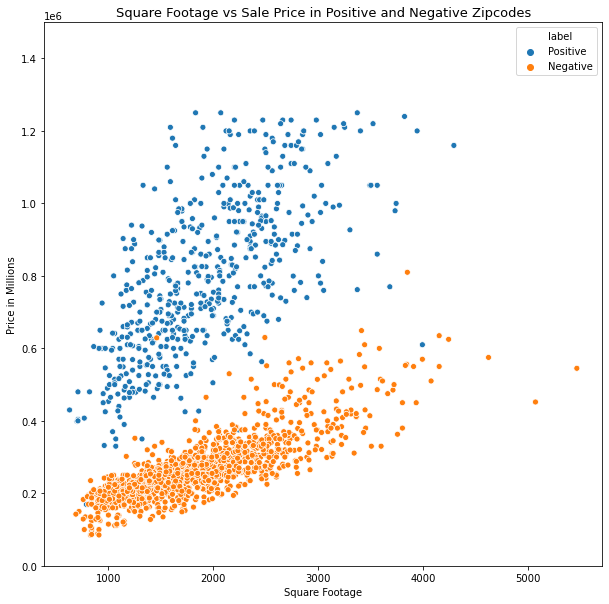

In [1094]:
# Sqft_living was next highest driver of price. Look at scattter plot in positive versus negative zipcodes 
# and relation of total square footage to price
plt.figure(figsize=(10,10))
sns.scatterplot(x=extreme_zips['sqft_living'], y=extreme_zips['price'], hue=extreme_zips['label'], ci=None)
plt.xlabel(xlabel='Square Footage')
plt.ylabel(ylabel='Price in Millions')
plt.ylim(0, 1500000)
plt.title('Square Footage vs Sale Price in Positive and Negative Zipcodes', size=13 )
plt.savefig("../images/Pos_Neg_Sq_Ft_Comp")
plt.show()
# These are almost parallel paths with negative zipcodes sitting consistently below the prices for the positive ones
# For homes in negative zipcodes, there is concentration especially for home from 1000-3000 square feet.
# Homes in positive zipcodes also have more variation in price range within a given zipcode. This also could be
# showing more prevalently as there is less records available on positive zipcodes

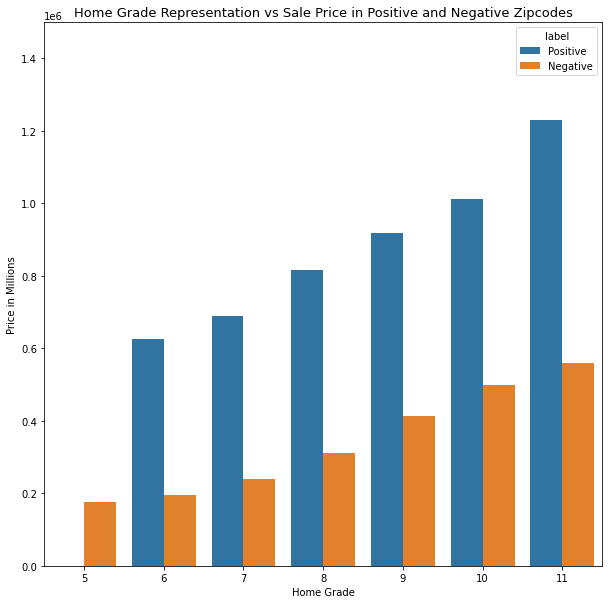

In [1095]:
# Grade was next highest driver of price. Look at availability of grades in positive versus negative zipcodes 
# and relation of grade to price
plt.figure(figsize=(10,10))
sns.barplot(x=extreme_zips['grade'], y=extreme_zips['price'], hue=extreme_zips['label'], ci=None)
plt.xlabel(xlabel='Home Grade')
plt.ylabel(ylabel='Price in Millions')
plt.ylim(0, 1500000)
plt.title('Home Grade Representation vs Sale Price in Positive and Negative Zipcodes', size=13 )
plt.savefig("../images/Pos_Neg_Home_Grade_Comp")
plt.show()
# Comparisons show that there is a consistent gap of at least $400k even in the lower range of grades between 
# homes in positive versus homes in negative zipcodes. Also positive zip homes are ~3x the price at similar grades 
# versus negative

In [1096]:
# Renovation is model's top driver
extreme_zips.groupby(by='has_been_renovated')['id'].count()
# Model has limited information about homes with renovations. Note to look into this data point and 
# expansion of data available in modeling

has_been_renovated
0    1877
1      50
Name: id, dtype: int64

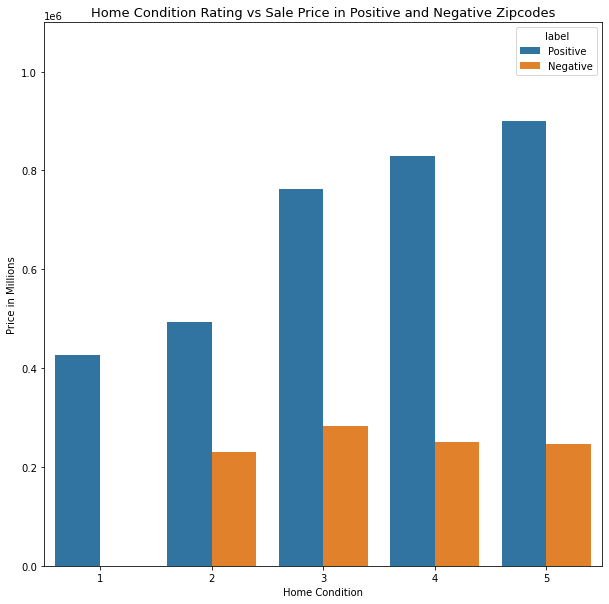

In [1097]:
# Condition was next highest driver of price. Look at availability of grades in positive versus negative zipcodes 
# and relation of grade to price
plt.figure(figsize=(10,10))
sns.barplot(x=extreme_zips['condition'], y=extreme_zips['price'], hue=extreme_zips['label'], ci=None)
plt.xlabel(xlabel='Home Condition')
plt.ylabel(ylabel='Price in Millions')
plt.ylim(0, 1100000)
plt.title('Home Condition Rating vs Sale Price in Positive and Negative Zipcodes', size=13 )
plt.savefig("../images/Pos_Neg_Home_Condition_Comp")
plt.show()
# Comparisons show that there is a consistent gap of at least $300k between homes in positive 
# versus homes in negative zipcodes in the same condititon. Can also see that homes in negative zips actually
# peak in price in condition rating of 3 and taper off in ratings 4 and 5, while positive zip home prices trend 
# upward consistently

## Data Analysis Learnings <a id="DAL"></a>

When looking at what would be considered general home features (beds, baths, condititon), the homes were extremely similar. Both averaged 3 beds and 1-1.5 full baths. They also shared average grade of 7-8 and condition rating of 3, which is an "Average" rating on both grade (1-13) and condition (1-5) scales. The grade rating also mentions that this rating is commonly seen in older subdivisions. Interestingly enough, homes are on average 25 years older in positive zipcodes. Where average home age is 37 years old in negative zipcodes, it is 62 years old in positive zipcodes. Yet, the major contrast is in the price, as expected, where median home price is 67 percent more in positive zips. 

In looking at top _home features_ that drove positive price, some lacked enough data to accurately inform the current model. This included waterfront, where there was a single property represented, and has_been_renovated, where only 50 had been renovation. This calls for further investigation on whether these are true positive drivers of price in this areas for future work.

When looking at square footage, there are parallel paths with negative zipcodes sitting consistently below the prices for the positive ones. For homes in negative zipcodes, there is concentration especially for home from 1000-3000 square feet. Homes in positive zipcodes also have more variation in price range within a given zipcode. This also could be showing more prevalently as there is less records available on positive zipcodes.

As for grade and condition, it was found that similar grades and conditions in positive versus negative zipcodes sell for very different prices. For grade (the higher positive price driver), there is a consistent gap of at least 400,000 USD even in the lower range of grades between homes in positive versus homes in negative zipcodes. Also positive zip homes are ~3x the price at similar grades versus negative. For condition comparisons show that there is a consistent gap of at least 300,000 USD between homes in positive versus homes in negative zipcodes in the same condititon. It can also be seen that homes in negative zips actually peak in price in condition rating of 3 and taper off in ratings 4 and 5, while positive zip home prices trend upward consistently.

## Recommendations On Model Utilization In Guiding Buyer Search:

#### If new to the area or starting with no information
- 98072: Woodinville (Northeast of Seattle, outside of city
- 98027: Issaquah (far East of Seattle, outside of the city)
- 98118: Seattle (Seward Park, Ranier Valley)


#### If area is priority and/or buyers have more budget (Top Positive Zipcodes):
- 98039: Medina
- 98004: Bellevue
- 98112: (Seattle: Mann, Central Area)
- 98102: (Seattle: Eastlake, Cascade)
- 98109: (Seattle: Westlake, Cascade)


#### Negative zipcodes
- Address as buyer drives the conversation
    

## Future Work

#### Buyer Homework When Utilizing This Model
Based on importance of area and features highly correlated with price, they should assess what is most important to them in a home. This will help us take more specific steps in their search. Since much of the price drivers are dependent on zipcode, it would be useful for buyers to do more contextual and qualitative research about the area as well.

#### Additional Data Analysis and Modeling
In general, King County has plenty of open source data to explore and add to this model. Some thats stood out include schools and test scores, public transit/walk/bike scores, as well as crime in specific areas (https://www.kingcounty.gov/services/data.aspx).
As for this model specifically and mentioned within Data Analysis section above, there were twice as many home records avaialable within negative zipcodes versus positive zipcodes. This impacts the model's quality of measurement. For instance, currently waterfront is a top driver of home price, but there is a single record. The availability of the data especially in these top drivers should be revisited.
Finally, due to the weight on zipcodes in driving price, there should be further research on the areas these zipcodes cover. On the surface the homes have seemingly similar stats beyond price, so there are clearly things not represented in the dataset that are driving these prices.